## Diffusion Showcase with Stable Diffusion

In [ ]:
#only for Google Colab
#for problems with package versions look in the requirements-colab-freeze.txt and requirements-pip-freeze.txt files
!pip install diffusers
!pip install jupyter_bbox_widget
!git clone https://github.com/benjaminstern/GenAI_files
from google.colab import output
output.enable_custom_widget_manager()

In [1]:
from PIL import Image, ImageDraw
from GenAI_files.diffusion_utils import randomImage, text2image, text2image_latent_walk_image, text2image_latent_walk_prompt, image2image, inpaint, text2image_prompt_merging, text2image_prompt_interpolation, plot_two_images, encode_image
from IPython.display import Image as DisplayImage
from jupyter_bbox_widget import BBoxWidget
from ipywidgets import Layout

/Users/benjamin/Library/CloudStorage/OneDrive-ZHAW/GenAI/diffusion/.venv/lib/python3.10/site-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


running on mps


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

### Random Image

  0%|          | 0/10 [00:00<?, ?it/s]

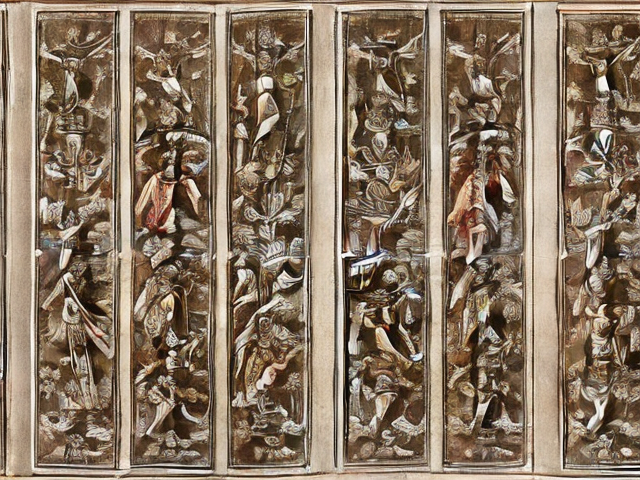

In [2]:
randomImage(num_inference_steps=20)

### Text to Image

_Lecuters notes mit oder ohne "a photo of"_

  0%|          | 0/20 [00:00<?, ?it/s]

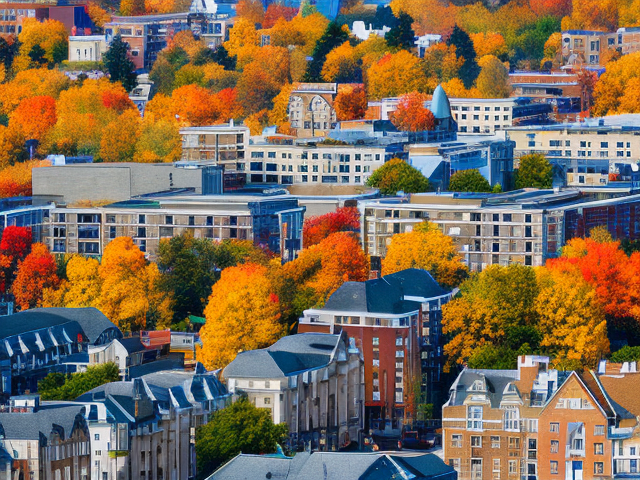

In [2]:
generated_image, gif_path = text2image("a photo of an autumn cityscape", num_inference_steps=20, seed=3, create_gif=True)
generated_image

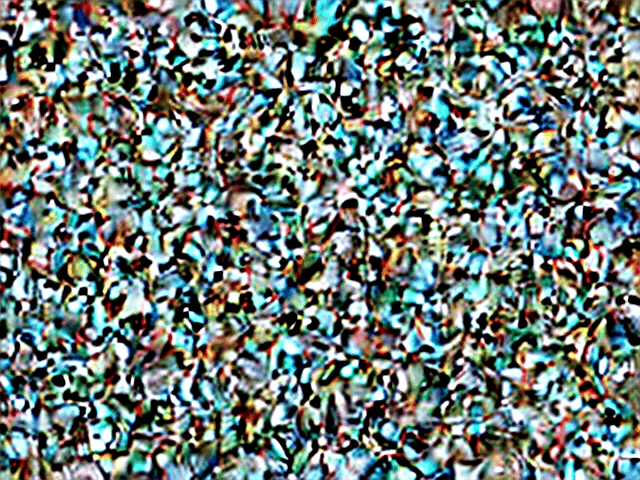

In [4]:
DisplayImage(filename=gif_path)

### Prompt changed a little

  0%|          | 0/20 [00:00<?, ?it/s]

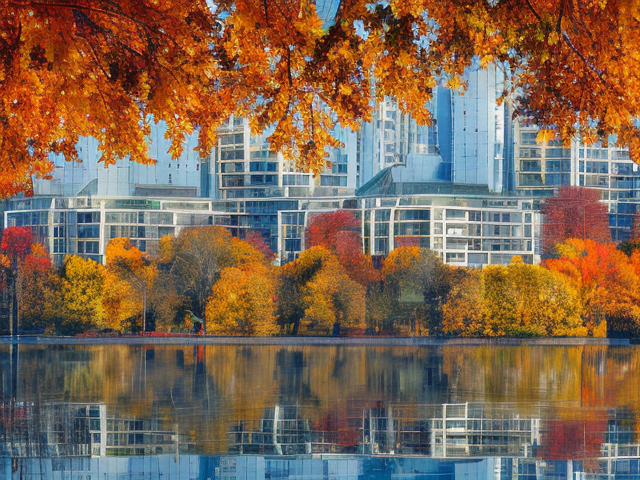

In [5]:
text2image("a photo of an autumn city", num_inference_steps=20, seed=3)

### Same prompt different noise

  0%|          | 0/20 [00:00<?, ?it/s]

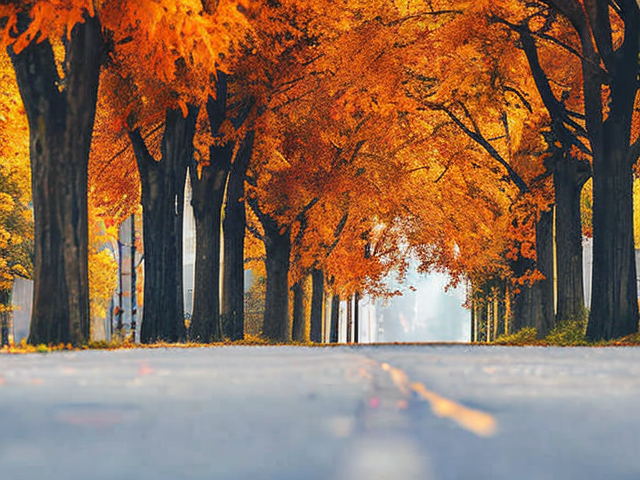

In [6]:
text2image("a photo of an autumn city", num_inference_steps=20, seed=4)

### Inpainting

In [63]:
widget = BBoxWidget(
    image=encode_image(generated_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='40%')
)
widget

BBoxWidget(colors=['#ff0000'], hide_buttons=True, image='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAgAAAAG…

  0%|          | 0/20 [00:00<?, ?it/s]

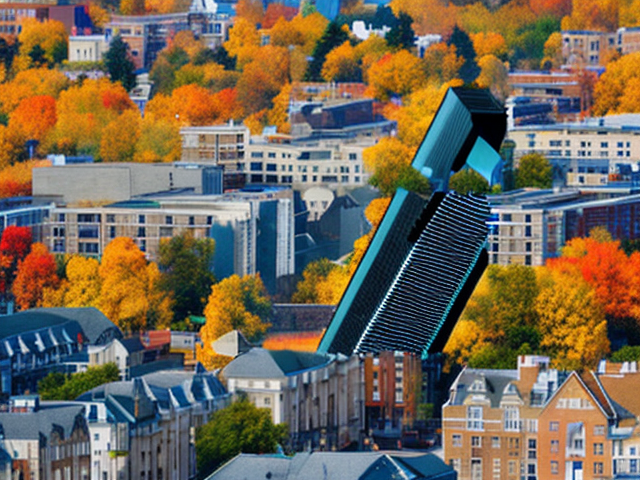

In [62]:
mask = Image.new('L', generated_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="skyscraper",
        init_image=generated_image,
        mask_image=mask,
        num_inference_steps=20)

### Image to Image

  0%|          | 0/12 [00:00<?, ?it/s]

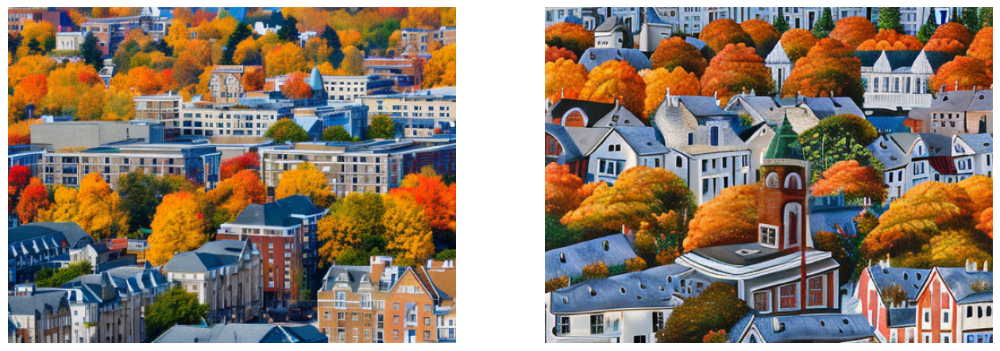

In [60]:
new_image = image2image(prompt="a photo of an autumn city with a boat", image=generated_image, strength=0.6)
plot_two_images(generated_image, new_image)


### Drawing to Image

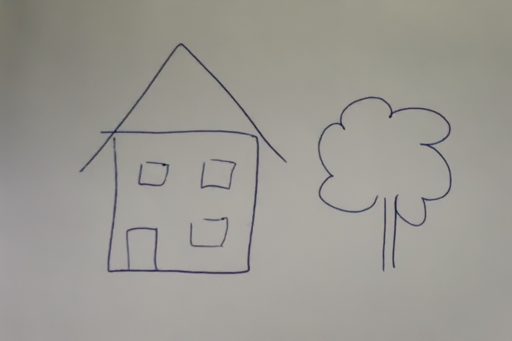

In [12]:
sketch = Image.open("GenAI_files/sketch.jpg")
sketch.thumbnail((512,512))
sketch

  0%|          | 0/30 [00:00<?, ?it/s]

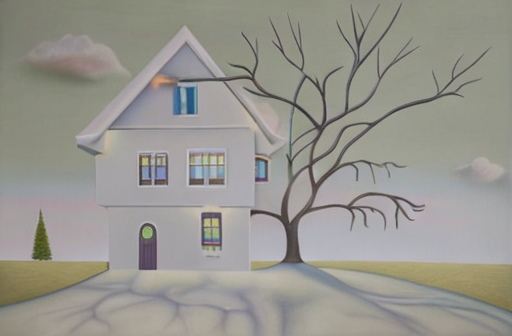

In [9]:
image2image(prompt="a colorful photorealistic image of a house with a tree", image_path="sketch.jpg", strength=0.6, num_inference_steps=50)

# Code for the slides

### Flag Inpainting

In [64]:
file_path = 'GenAI_files/inpainting-samples/flagge.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#000000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 798, 'y': 611, 'width': 492, 'height': 441, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 798, 'y': 611, 'width': 492, 'height': 441, 'label': 'mask'}], classes=['mask'], colo…

In [65]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

#less steps seem to work better, for this simple image
inpaint(prompt="red and white only",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=15,
        seed=1)

  0%|          | 0/15 [00:00<?, ?it/s]

KeyboardInterrupt: 

### House Inpainting

In [ ]:
file_path = 'GenAI_files/inpainting-samples/haus.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 94, 'y': 59, 'width': 55, 'height': 40, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 94, 'y': 59, 'width': 55, 'height': 40, 'label': 'mask'}], classes=['mask'], colors=[…

  0%|          | 0/30 [00:00<?, ?it/s]

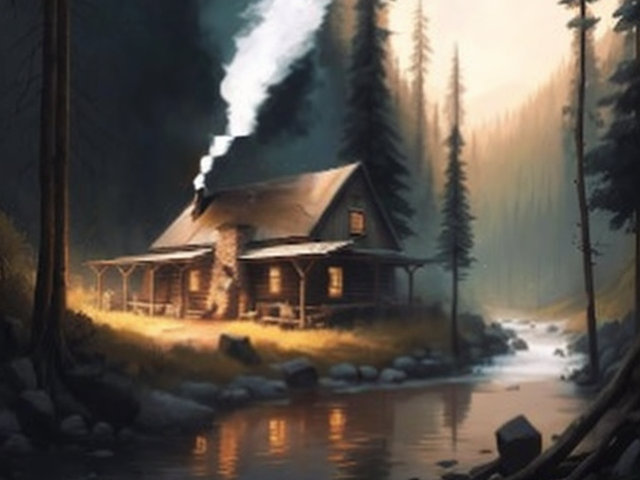

In [ ]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="chimney of a cottage",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=30,
        seed=25)

### Landscape Inpainting

In [ ]:
file_path = 'GenAI_files/inpainting-samples/landschaft.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 44, 'y': 34, 'width': 181, 'height': 123, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 44, 'y': 34, 'width': 181, 'height': 123, 'label': 'mask'}], classes=['mask'], colors…

  0%|          | 0/20 [00:00<?, ?it/s]

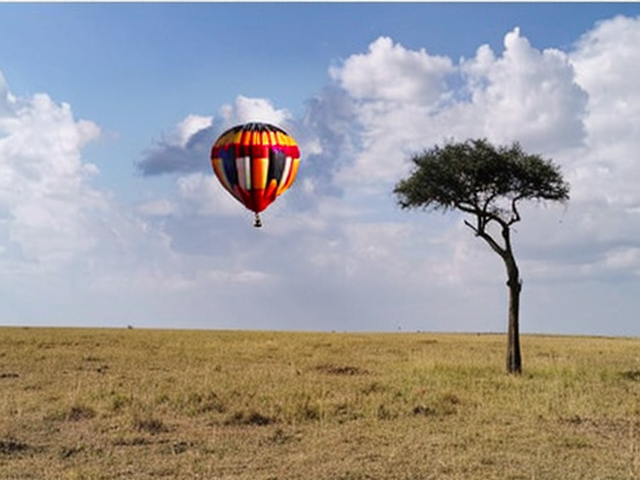

In [ ]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

# "fully visible" seems to help with inpainting
inpaint(prompt="hot air balloon, fully visible",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=20,
        seed=3)

### TV Inpainting

In [ ]:
file_path = 'GenAI_files/inpainting-samples/tv.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 168, 'y': 42, 'width': 262, 'height': 152, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 168, 'y': 42, 'width': 262, 'height': 152, 'label': 'mask'}], classes=['mask'], color…

  0%|          | 0/50 [00:00<?, ?it/s]

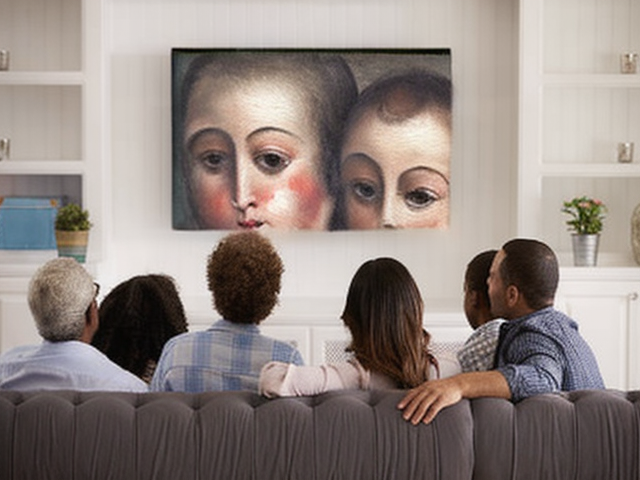

In [ ]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="old oil painting",
       init_image=starting_image,
       mask_image=mask,
       num_inference_steps=50,
       seed=3)

# inpaint(prompt="tv image of a soccer match",
#         init_image=starting_image,
#         mask_image=mask,
#         num_inference_steps=50,
#         seed=3)

# Additional Material

### Stable Diffusion Prompt Merging

  0%|          | 0/20 [00:00<?, ?it/s]

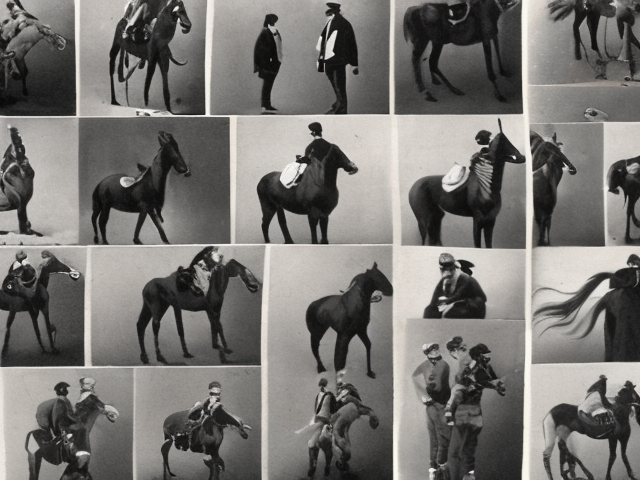

In [19]:
text2image_prompt_merging(prompt1="horse", prompt2="human", mix_factor=0.4, num_inference_steps=20)

### Stable Diffusion Prompt Interpolation

In [34]:
generated_image, gif_path = text2image_prompt_interpolation(prompt1="An octopus", prompt2="An elephant", num_interpolation_steps=30, num_inference_steps=10)
Image(filename=gif_path)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

TypeError: 'module' object is not callable

### Walking through latent space

  0%|          | 0/35 [00:00<?, ?it/s]

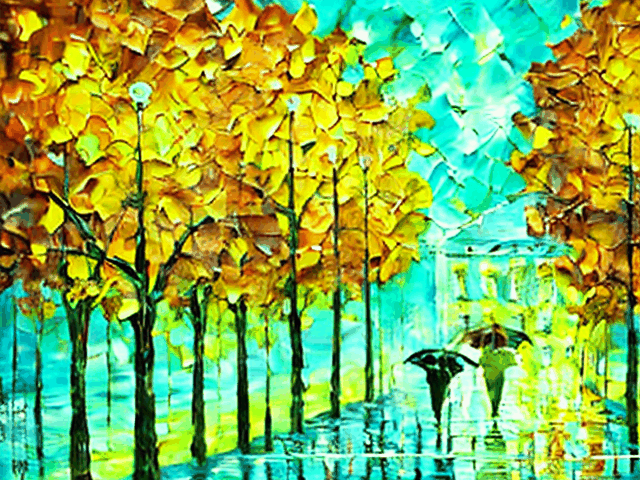

In [4]:
generated_image, gif_path = text2image_latent_walk_image("Palette knife painting of an autumn cityscape", num_inference_steps=35)
DisplayImage(filename=gif_path)

### Walking through prompt space

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

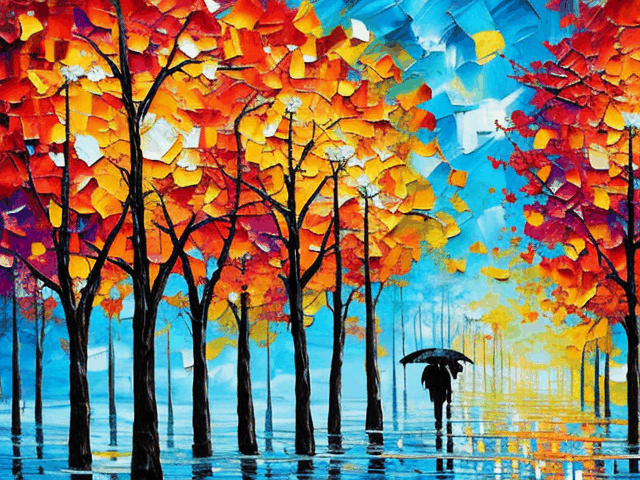

In [5]:
generated_image, gif_path = text2image_latent_walk_prompt("Palette knife painting of an autumn cityscape")
DisplayImage(filename=gif_path)